__ESERCITAZIONE CON MAPPE ANNOTATE E CHOROPLETH MAPS__

L'uso di mappe si sta diffondendo anche al di fuori dell'ambito strettamente cartografico ed esistono vari strumenti per poterle utilizzare in un progetto di data analysis. La visualizzazione attraverso mappe geografiche può arricchire la presentazione dei risultati e offrire una valida soluzione per comunicare sia una visione di sintesi che dettagli. La possibilità di renderle interattive è inoltre un ottimo ausilio quando si usa un supporto interattivo come i Jupyter Notebook o un sito web.
Tuttavia, per quanto ormai citate in molti dei testi riguardante data analysis, manca ancora una documentazione completa e consistente, essendo la gran parte dei package ancora spesso in via di sviluppo da parte di piccoli gruppi di sviluppatori indipendenti.
Quindi, bisogna muoversi in un contesto con informazioni ancora frammentarie (blog, forum, repisitory GitHub etc.), soprattutto volendo fare passi avanti rispetto gli usi più semplici, e package che spesso presentano problemi di installazione e funzionamento perché ancora poco standard o dipendenti dalle particolari versioni di software di base.
Bisogna mettere in conto alcune difficoltà e armarsi di pazienza per cercare soluzioni ai problemi, ma i risultati che si possono ottenere sono già di buon livello e resa grafica.


___RIFERIMENTI___

Qui un elenco di riferimenti a blog, forum e repository GitHub utili

__Generali__
- https://towardsdatascience.com/best-libraries-for-geospatial-data-visualisation-in-python-d23834173b35
- https://towardsdatascience.com/interactive-geospatial-data-visualization-with-geoviews-in-python-7d5335c8efd1

__Folium__
- https://deparkes.co.uk/2016/06/10/folium-map-tiles/
- https://www.datasciencearth.com/en/map-visualization-with-folium/
- https://python-visualization.github.io/folium/quickstart.html
- https://python-graph-gallery.com/292-choropleth-map-with-folium/
- https://nbviewer.jupyter.org/github/carnot-technologies/MapVisualizations/blob/master/FoliumChoroplethDemo.ipynb
- https://github.com/JUGG097/folium-choropleth-map
- https://medium.com/analytics-vidhya/interactive-choropleth-map-in-python-using-folium-4e1479d9e568
- https://github.com/ArchaDoriya/Interactive-Choropleth-Map-in-Python-and-Folium/blob/master/Interactive%20Choropleth%20Map%20using%20folium.ipynb
- https://towardsdatascience.com/choropleth-maps-with-folium-1a5b8bcdd392

__Geopandas__
- https://geopandas.org/mapping.html
- https://github.com/bendoesdata/make-a-map-geopandas/blob/master/README.md

__Folium e Geopandas__
- https://nbviewer.jupyter.org/github/python-visualization/folium/blob/master/examples/GeoJsonPopupAndTooltip.ipynb
- https://nbviewer.jupyter.org/github/python-visualization/folium/blob/e7f9c831b5df20918ee5c58aaccabc56a5bff163/examples/GeoPandas.ipynb
- https://github.com/python-visualization/folium/issues/499

__Plotly e Dash__
- https://plotly.com/
- https://dash-gallery.plotly.host/Portal/

__Data Wrapper__
- https://app.datawrapper.de/create/map

__Mapshaper__
- https://mapshaper.org/


___MAPPE ANNOTATE___

Iniziamo usando mappe sulle quali vogliamo sistemare elementi per annotarle.
Esistono vari package che permettono di lavorare con le mappe. 
Usiamo **folium** (per installazione e esempi: https://python-visualization.github.io/folium/index.html)

In [1]:
import folium

Prendiamo la mappa del centro di Milano attorno a Via Conservatorio e posizioniamo dei marker.
Come trovare le coordinate? Ad esempio con Google Maps (non precisissimo, https://www.google.com/maps), o OpenStreetMaps (più preciso, https://www.openstreetmap.org/) 

In [2]:
m = folium.Map(location=[45.4613,9.1595], tiles= "Stamen Toner", zoom_start=14)

Ora troviamo le coordinate di qualche punto di interesse e posizioniamo dei marker. 
Si possono scegliere il colore e le icone, in un set standard o in alcuni icon set (prefix='fa' è il riferimento all'icon set Font Awesome https://fontawesome.com/icons?d=gallery).
Indichiamo anche la dicitura che deve apparire nel pop-up.

In [3]:
folium.Marker(
    location=[45.46557,9.20281],
    popup='SPS',
    icon=folium.Icon(icon='cloud')
).add_to(m)

folium.Marker(
    location=[45.46642, 9.19739],
    popup='Piazza San Babila',
    icon=folium.Icon(color='red', icon='train', prefix='fa')
).add_to(m)

folium.Marker(
    location=[45.46712, 9.20175],
    popup='Fermata Bus',
    icon=folium.Icon(color='green', icon='bus', prefix='fa')
).add_to(m)

In [4]:
m

Come prima ma invece dei marker definiamo delle aree circolari.
Il raggio e il colore sono tra le opzioni da selezionare.

In [5]:
m1 = folium.Map(location=[45.4613,9.1595], zoom_start=14)

folium.Circle(
    radius=70,
    location=[45.4657,9.2024],
    popup='Dipartimento SPS',
    color='crimson',
    fill=False,
).add_to(m1)

folium.CircleMarker(
    location=[45.46642, 9.19739],
    radius=50,
    popup='Piazza San Babila',
    color='#3186cc',
    fill=True,
    fill_color='#3186cc'
).add_to(m1)


In [6]:
m1.add_child(folium.LatLngPopup())
m1

Per i marker e le aree esistono altre opzioni, come ad esempio la possibilità di raggruppare i marker presenti in una zona indicandone il numero, oppure definire aree con gradiente di colore che cambia al cambiare della densità dei marker. 

Vediamo ora invece le **Choropleth Maps**.

Le choropleth maps sono mappe che usano un formato geografico che identifica i confini di aree geografiche 
(es. stati, regioni, province, quartieri) e alle aree associano il valore di una variabile (es. popolazione residente, reddito medio, percentuale di incidenti, etc.). Infine, le diverse aree vengono colorate secondo un gradiente di colore che cambia rispetto i valori della variabile associata.

Ad esempio, la ben nota colorazione delle regioni italiane per livelli di lockdown a causa del Covid-19 è una choropleth map. Altri esempi di choropleth maps:<img src='./regioni-covid.png' width="200" height="200"> <img src='./london_map.jpg' width="400" height="400"> <img src='./world_map.png' width="600" height="600">

In [7]:
import numpy as np
import pandas as pd
import folium
import os
import json
import requests

Nel repository GitHub di OpenPolis (https://github.com/openpolis/geojson-italy) troviamo le mappe per regioni, provincie e comuni italiani in formato geoJSON e topoJSON (https://en.wikipedia.org/wiki/GeoJSON).

Un formato molto comune per mappe geografiche è lo shape file (SHP). Ad esempio è il formato delle mappe che si possono scaricare da OpenStreetMap o che si trovano in numerosi repository online (es. https://www.statsilk.com/maps/download-free-shapefile-maps , https://www.eea.europa.eu/data-and-maps/data/eea-reference-grids-2/gis-files/italy-shapefile , ). Esistono convertitori per SHP -> geoJSON (es. https://mapshaper.org/)

Qui usiamo la mappa delle regioni italiane in formato topoJSON scaricata da OpenPolis e le funzioni di folium

In [8]:
with open('/Users/teddy/teddy-g4/Computer_and_Society/dataset/limits_IT_regions.topo.json') as f:
  regioni_topo = json.load(f)

Guardiamo il formato di questi dati: è di tipo dizionario (dict, https://docs.python.org/3/library/stdtypes.html#typesmapping) quindi non è un data frame che possiamo utilizzare con le funzioni di pandas

In [9]:
type(regioni_topo)

dict

In [10]:
regioni_topo

{'type': 'Topology',
 'arcs': [[[1391, 35912],
   [-40, 68],
   [-32, 107],
   [65, 11],
   [14, 74],
   [57, 31],
   [11, 82],
   [61, 78],
   [-92, 72],
   [-102, 40],
   [-37, 76],
   [9, 46]],
  [[1305, 36597],
   [60, 165],
   [31, 16],
   [17, -70],
   [36, -39],
   [116, -19],
   [63, -40],
   [68, 87],
   [43, 17],
   [17, 59],
   [146, -1],
   [113, 39],
   [32, -32],
   [127, 109],
   [70, 34],
   [62, 82],
   [96, 16],
   [73, -18],
   [90, 53],
   [92, -49],
   [28, -56],
   [68, 29],
   [117, -69],
   [31, 19],
   [42, -6],
   [74, -18],
   [6, -1],
   [13, 6],
   [162, 112],
   [-2, 14],
   [145, 58],
   [36, -20],
   [7, 2],
   [85, -26],
   [4, 59],
   [-2, 19],
   [2, 4],
   [50, 75],
   [56, 10],
   [9, 27],
   [-37, 45],
   [-38, 56],
   [-18, 42],
   [41, 73],
   [10, 15],
   [16, 32],
   [19, 35],
   [-26, 38],
   [5, 29],
   [-79, 25],
   [-102, 153],
   [-2, 105],
   [4, 72],
   [34, 81],
   [-20, 23],
   [-13, 179]],
  [[3382, 38247],
   [36, 37],
   [2, 167],
 

Ora esploriamo la struttura del dizionario con le funzioni keys(), values(), items()

In [11]:
regioni_topo.keys()

dict_keys(['type', 'arcs', 'bbox', 'transform', 'objects'])

In [12]:
regioni_topo.values()

dict_values(['Topology', [[[1391, 35912], [-40, 68], [-32, 107], [65, 11], [14, 74], [57, 31], [11, 82], [61, 78], [-92, 72], [-102, 40], [-37, 76], [9, 46]], [[1305, 36597], [60, 165], [31, 16], [17, -70], [36, -39], [116, -19], [63, -40], [68, 87], [43, 17], [17, 59], [146, -1], [113, 39], [32, -32], [127, 109], [70, 34], [62, 82], [96, 16], [73, -18], [90, 53], [92, -49], [28, -56], [68, 29], [117, -69], [31, 19], [42, -6], [74, -18], [6, -1], [13, 6], [162, 112], [-2, 14], [145, 58], [36, -20], [7, 2], [85, -26], [4, 59], [-2, 19], [2, 4], [50, 75], [56, 10], [9, 27], [-37, 45], [-38, 56], [-18, 42], [41, 73], [10, 15], [16, 32], [19, 35], [-26, 38], [5, 29], [-79, 25], [-102, 153], [-2, 105], [4, 72], [34, 81], [-20, 23], [-13, 179]], [[3382, 38247], [36, 37], [2, 167], [85, 92], [216, -3], [66, 58], [2, 73], [58, 49], [-31, 84], [27, 111], [206, 48], [19, 68], [78, 24], [17, 83], [42, 64], [-32, 55], [-39, 126], [-39, 13], [-40, 72], [-79, 34], [154, 159], [65, -20], [95, 23], [4

In [13]:
regioni_topo.items()

dict_items([('type', 'Topology'), ('arcs', [[[1391, 35912], [-40, 68], [-32, 107], [65, 11], [14, 74], [57, 31], [11, 82], [61, 78], [-92, 72], [-102, 40], [-37, 76], [9, 46]], [[1305, 36597], [60, 165], [31, 16], [17, -70], [36, -39], [116, -19], [63, -40], [68, 87], [43, 17], [17, 59], [146, -1], [113, 39], [32, -32], [127, 109], [70, 34], [62, 82], [96, 16], [73, -18], [90, 53], [92, -49], [28, -56], [68, 29], [117, -69], [31, 19], [42, -6], [74, -18], [6, -1], [13, 6], [162, 112], [-2, 14], [145, 58], [36, -20], [7, 2], [85, -26], [4, 59], [-2, 19], [2, 4], [50, 75], [56, 10], [9, 27], [-37, 45], [-38, 56], [-18, 42], [41, 73], [10, 15], [16, 32], [19, 35], [-26, 38], [5, 29], [-79, 25], [-102, 153], [-2, 105], [4, 72], [34, 81], [-20, 23], [-13, 179]], [[3382, 38247], [36, 37], [2, 167], [85, 92], [216, -3], [66, 58], [2, 73], [58, 49], [-31, 84], [27, 111], [206, 48], [19, 68], [78, 24], [17, 83], [42, 64], [-32, 55], [-39, 126], [-39, 13], [-40, 72], [-79, 34], [154, 159], [65, 

In [14]:
regioni_topo['objects'].keys()

dict_keys(['regions'])

In [15]:
regioni_topo['objects']['regions']

{'type': 'GeometryCollection',
 'geometries': [{'arcs': [[0, 1, 2, 3, 4, 5, 6]],
   'type': 'Polygon',
   'properties': {'reg_name': 'Piemonte',
    'reg_istat_code_num': 1,
    'reg_istat_code': '01'}},
  {'arcs': [[7, -2, 8]],
   'type': 'Polygon',
   'properties': {'reg_name': "Valle d'Aosta/Vallée d'Aoste",
    'reg_istat_code_num': 2,
    'reg_istat_code': '02'}},
  {'arcs': [[[-4, 9, 10, 11, 12]], [[13]]],
   'type': 'MultiPolygon',
   'properties': {'reg_name': 'Lombardia',
    'reg_istat_code_num': 3,
    'reg_istat_code': '03'}},
  {'arcs': [[14, -11, 15, 16]],
   'type': 'Polygon',
   'properties': {'reg_name': 'Trentino-Alto Adige/Südtirol',
    'reg_istat_code_num': 4,
    'reg_istat_code': '04'}},
  {'arcs': [[-12, -15, -17, 17, 18, 19, 20]],
   'type': 'Polygon',
   'properties': {'reg_name': 'Veneto',
    'reg_istat_code_num': 5,
    'reg_istat_code': '05'}},
  {'arcs': [[21, -19, 22]],
   'type': 'Polygon',
   'properties': {'reg_name': 'Friuli-Venezia Giulia',
    'reg

In [16]:
regioni_topo['objects']['regions']['geometries']

[{'arcs': [[0, 1, 2, 3, 4, 5, 6]],
  'type': 'Polygon',
  'properties': {'reg_name': 'Piemonte',
   'reg_istat_code_num': 1,
   'reg_istat_code': '01'}},
 {'arcs': [[7, -2, 8]],
  'type': 'Polygon',
  'properties': {'reg_name': "Valle d'Aosta/Vallée d'Aoste",
   'reg_istat_code_num': 2,
   'reg_istat_code': '02'}},
 {'arcs': [[[-4, 9, 10, 11, 12]], [[13]]],
  'type': 'MultiPolygon',
  'properties': {'reg_name': 'Lombardia',
   'reg_istat_code_num': 3,
   'reg_istat_code': '03'}},
 {'arcs': [[14, -11, 15, 16]],
  'type': 'Polygon',
  'properties': {'reg_name': 'Trentino-Alto Adige/Südtirol',
   'reg_istat_code_num': 4,
   'reg_istat_code': '04'}},
 {'arcs': [[-12, -15, -17, 17, 18, 19, 20]],
  'type': 'Polygon',
  'properties': {'reg_name': 'Veneto',
   'reg_istat_code_num': 5,
   'reg_istat_code': '05'}},
 {'arcs': [[21, -19, 22]],
  'type': 'Polygon',
  'properties': {'reg_name': 'Friuli-Venezia Giulia',
   'reg_istat_code_num': 6,
   'reg_istat_code': '06'}},
 {'arcs': [[23, -6, 24, 

In [17]:
regioni_topo['objects']['regions']['geometries'][0].keys()

dict_keys(['arcs', 'type', 'properties'])

In [18]:
regioni_topo['objects']['regions']['geometries'][0]['properties'].keys()

dict_keys(['reg_name', 'reg_istat_code_num', 'reg_istat_code'])

In [19]:
regioni_topo['objects']['regions']['geometries'][3]['properties']['reg_name']

'Trentino-Alto Adige/Südtirol'

Abbiamo capito la struttura del dizionario. 
Ora leggiamo il csv delle regioni con le variabili

In [20]:
regioni = pd.read_csv('/Users/teddy/teddy-g4/Computer_and_Society/dataset/italy_regions.csv', sep=';', usecols=['regione','superficie', 'num_residenti','num_comuni', 'num_provincie'])
regioni

,regione,superficie,num_residenti,num_comuni,num_provincie
0,Abruzzo,10831.84,1326513.0,305.0,4.0
1,Basilicata,10073.32,573694.0,131.0,2.0
2,Calabria,15221.90,1970521.0,409.0,5.0
3,Campania,13670.95,5850850.0,550.0,5.0
4,Emilia-Romagna,22452.78,4448146.0,333.0,9.0
5,Friuli-Venezia Giulia,7862.30,1221218.0,216.0,4.0
6,Lazio,17232.29,5888472.0,378.0,5.0
7,Liguria,5416.21,1571053.0,235.0,4.0
8,Lombardia,23863.65,10008349.0,1524.0,12.0
9,Marche,9401.38,1543752.0,229.0,5.0


Con la funzione Choropleth di folium associamo il dizionario ricavato dal file topoJSON (regioni_topo) al data frame ricavato dal file csv (regioni) utilizzando le colonne 'regione' e 'num_residenti'. I valori della colonna regione verranno associati ai valori dei valori delle key feature.properties.reg_name.
Per le palette predefinite di Color Brewer: https://www.cgl.ucsf.edu/chimerax/docs/user/commands/palettes.html

In [21]:
m2 = folium.Map(location=[41.706, 12.568], zoom_start=6)

folium.Choropleth(
    geo_data=regioni_topo,
    name='choropleth',
    data=regioni,
    columns=['regione', 'num_residenti'],
    topojson='objects.regions',
    key_on='feature.properties.reg_name',
    fill_color='Oranges',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Residenti'
).add_to(m2)

folium.LayerControl().add_to(m2)

m2

C'è un errore, Valle d'Aosta e Trentino Alto Adige non sono visualizzati correttamente. Problema con i nomi che non coincidono. Li cambiamo nel data frame per allinearli a quelli della mappa geografica

In [22]:
regioni.dropna(inplace=True)
regioni['regione'][18]="Valle d'Aosta/Vallée d'Aoste"
regioni['regione'][16]="Trentino-Alto Adige/Südtirol"
regioni

<ipython-input-22-ba2cd0f0a3c1>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  regioni['regione'][18]="Valle d'Aosta/Vallée d'Aoste"
<ipython-input-22-ba2cd0f0a3c1>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  regioni['regione'][16]="Trentino-Alto Adige/Südtirol"


,regione,superficie,num_residenti,num_comuni,num_provincie
0,Abruzzo,10831.84,1326513.0,305.0,4.0
1,Basilicata,10073.32,573694.0,131.0,2.0
2,Calabria,15221.90,1970521.0,409.0,5.0
3,Campania,13670.95,5850850.0,550.0,5.0
4,Emilia-Romagna,22452.78,4448146.0,333.0,9.0
5,Friuli-Venezia Giulia,7862.30,1221218.0,216.0,4.0
6,Lazio,17232.29,5888472.0,378.0,5.0
7,Liguria,5416.21,1571053.0,235.0,4.0
8,Lombardia,23863.65,10008349.0,1524.0,12.0
9,Marche,9401.38,1543752.0,229.0,5.0


In [23]:
m2 = folium.Map(location=[41.706, 12.568], zoom_start=6)

folium.Choropleth(
    geo_data=regioni_topo,
    name='choropleth',
    data=regioni,
    columns=['regione', 'num_residenti'],
    topojson='objects.regions',
    key_on='feature.properties.reg_name',
    fill_color='Oranges',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Residenti'
).add_to(m2)

folium.LayerControl().add_to(m2)

m2

Ora va bene.
Adesso, rifacciamo, ma usando il file geoJSON di OpenPolis

In [24]:
with open('/Users/teddy/teddy-g4/Computer_and_Society/dataset/limits_IT_regions.geojson') as f1:
  regioni_geo = json.load(f1)

Come prima, dobbiamo trovare il percorso ai valori con i nomi delle regioni, per il match con i valori del data frame

In [25]:
regioni_geo.keys()

dict_keys(['type', 'bbox', 'features'])

In [26]:
regioni_geo['features'][0]['properties']['reg_name']

'Piemonte'

In [27]:
m = folium.Map(location=[41.706, 12.568], zoom_start=6)

folium.Choropleth(
    geo_data=regioni_geo,
    fill_opacity=0.3,
    line_weight=2,
).add_to(m)

m

Ora possiamo anche provare le diverse tiles compatibili con folium 
(togliere il commento alla riga che si vuole testare)

In [80]:
#da https://deparkes.co.uk/2016/06/10/folium-map-tiles/

my_map = folium.Map(location=[41.706, 12.568], tiles= None, zoom_start=6)

# Open Street Map
#folium.TileLayer('openstreetmap').add_to(my_map)
#MapBox
#folium.TileLayer('Mapbox Control Room').add_to(my_map)
#folium.TileLayer('Mapbox Bright').add_to(my_map)
# Stamen
folium.TileLayer('stamenterrain').add_to(my_map)
#folium.TileLayer('stamentoner').add_to(my_map)
#folium.TileLayer('stamenwatercolor').add_to(my_map)
# CartoDB
#folium.TileLayer('cartodbpositron').add_to(my_map)
#folium.TileLayer('cartodbdark_matter').add_to(my_map)


folium.Choropleth(
    geo_data=regioni_geo,
    name='choropleth',
    data=regioni,
    columns=['regione', 'num_residenti'],
    key_on='feature.properties.reg_name',
    fill_color='Blues',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Residenti',
    highlight=True
).add_to(my_map)

folium.LayerControl().add_to(my_map)

my_map

Ora la rendiamo interattiva, con il pop-up

In [29]:
m21 = folium.Map(location=[41.706, 12.568], zoom_start=6)

choro=folium.Choropleth(
    geo_data=regioni_topo,
    name='choropleth',
    data=regioni,
    columns=['regione', 'num_residenti'],
    topojson='objects.regions',
    key_on='feature.properties.reg_name',
    fill_color='Oranges',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Residenti'
).add_to(m21)

choro.geojson.add_child(
    folium.features.GeoJsonTooltip(['reg_name'])
)
m21

Qui con qualche opzione in più

In [30]:
choro.geojson.add_child(
    folium.features.GeoJsonTooltip(
        fields=['reg_name'],
        aliases=['Nome Regione: '],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)

In [31]:
m21

__GEOPANDAS__

La libreria geopandas offre sostanzialmente una funziona utile: quella di leggere un file json con coordinate geografiche (geo json) cone un dataframe pandas.

Attenzione: l'installazione e l'import di geopandas facilmente produce errori di vario genere. Non c'è un modo semplice per risolverli. Il mio consiglio è di non perdere molto tempo per cercare di sistemarli, perché geopandas è utile ma non indispensabile per usare le choropleth maps, esistono altri modi e librerie. 

In [32]:
import geopandas as gpd
import matplotlib.pyplot as plt

In [33]:
regioni_topo2 = gpd.read_file(
    '/Users/teddy/teddy-g4/Computer_and_Society/dataset/limits_IT_regions.geojson',
    driver='GeoJSON')

In [34]:
regioni_topo2

,reg_name,reg_istat_code_num,reg_istat_code,geometry
0,Piemonte,1,01,"POLYGON ((7.13605 45.27996, 7.13601 45.28040, ..."
1,Valle d'Aosta/Vallée d'Aoste,2,02,"POLYGON ((7.73455 45.92365, 7.73590 45.92744, ..."
2,Lombardia,3,03,"MULTIPOLYGON (((8.57964 45.75172, 8.57532 45.7..."
3,Trentino-Alto Adige/Südtirol,4,04,"POLYGON ((12.01396 46.55091, 12.01376 46.55077..."
4,Veneto,5,05,"POLYGON ((10.63538 45.53543, 10.63228 45.56846..."
5,Friuli-Venezia Giulia,6,06,"MULTIPOLYGON (((13.51691 46.38301, 13.51750 46..."
6,Liguria,7,07,"MULTIPOLYGON (((7.55166 43.89429, 7.56264 43.9..."
7,Emilia-Romagna,8,08,"MULTIPOLYGON (((9.33258 44.73504, 9.33167 44.7..."
8,Toscana,9,09,"MULTIPOLYGON (((9.89786 44.16359, 9.89451 44.1..."
9,Umbria,10,10,"MULTIPOLYGON (((13.15849 42.65425, 13.15764 42..."


In [35]:
regioni_geo2=gpd.GeoDataFrame.from_file('/Users/teddy/teddy-g4/Computer_and_Society/dataset/limits_IT_regions.geojson')

In [36]:
regioni_geo2

,reg_name,reg_istat_code_num,reg_istat_code,geometry
0,Piemonte,1,01,"POLYGON ((7.13605 45.27996, 7.13601 45.28040, ..."
1,Valle d'Aosta/Vallée d'Aoste,2,02,"POLYGON ((7.73455 45.92365, 7.73590 45.92744, ..."
2,Lombardia,3,03,"MULTIPOLYGON (((8.57964 45.75172, 8.57532 45.7..."
3,Trentino-Alto Adige/Südtirol,4,04,"POLYGON ((12.01396 46.55091, 12.01376 46.55077..."
4,Veneto,5,05,"POLYGON ((10.63538 45.53543, 10.63228 45.56846..."
5,Friuli-Venezia Giulia,6,06,"MULTIPOLYGON (((13.51691 46.38301, 13.51750 46..."
6,Liguria,7,07,"MULTIPOLYGON (((7.55166 43.89429, 7.56264 43.9..."
7,Emilia-Romagna,8,08,"MULTIPOLYGON (((9.33258 44.73504, 9.33167 44.7..."
8,Toscana,9,09,"MULTIPOLYGON (((9.89786 44.16359, 9.89451 44.1..."
9,Umbria,10,10,"MULTIPOLYGON (((13.15849 42.65425, 13.15764 42..."


Ora che abbiamo i due data frame, possiamo unirli con una join per avere un data frame complessivo con dati demografici e geografici

In [37]:
regioni_demogeo= pd.merge(regioni_topo2, regioni, left_on="reg_name", right_on="regione").drop('regione', axis=1)
regioni_demogeo

,reg_name,reg_istat_code_num,reg_istat_code,geometry,superficie,num_residenti,num_comuni,num_provincie
0,Piemonte,1,01,"POLYGON ((7.13605 45.27996, 7.13601 45.28040, ...",25387.07,4404246.0,1201.0,8.0
1,Valle d'Aosta/Vallée d'Aoste,2,02,"POLYGON ((7.73455 45.92365, 7.73590 45.92744, ...",3260.90,127329.0,74.0,1.0
2,Lombardia,3,03,"MULTIPOLYGON (((8.57964 45.75172, 8.57532 45.7...",23863.65,10008349.0,1524.0,12.0
3,Trentino-Alto Adige/Südtirol,4,04,"POLYGON ((12.01396 46.55091, 12.01376 46.55077...",13605.50,1059114.0,293.0,2.0
4,Veneto,5,05,"POLYGON ((10.63538 45.53543, 10.63228 45.56846...",18407.42,4915123.0,576.0,7.0
5,Friuli-Venezia Giulia,6,06,"MULTIPOLYGON (((13.51691 46.38301, 13.51750 46...",7862.30,1221218.0,216.0,4.0
6,Liguria,7,07,"MULTIPOLYGON (((7.55166 43.89429, 7.56264 43.9...",5416.21,1571053.0,235.0,4.0
7,Emilia-Romagna,8,08,"MULTIPOLYGON (((9.33258 44.73504, 9.33167 44.7...",22452.78,4448146.0,333.0,9.0
8,Toscana,9,09,"MULTIPOLYGON (((9.89786 44.16359, 9.89451 44.1...",22987.04,3744398.0,276.0,10.0
9,Umbria,10,10,"MULTIPOLYGON (((13.15849 42.65425, 13.15764 42...",8464.33,891181.0,92.0,2.0


Dalla documentazione di geopandas: https://geopandas.org/mapping.html

<AxesSubplot:>

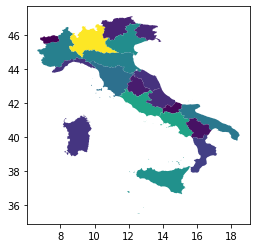

In [39]:
regioni_demogeo.plot(column='num_residenti')

<AxesSubplot:>

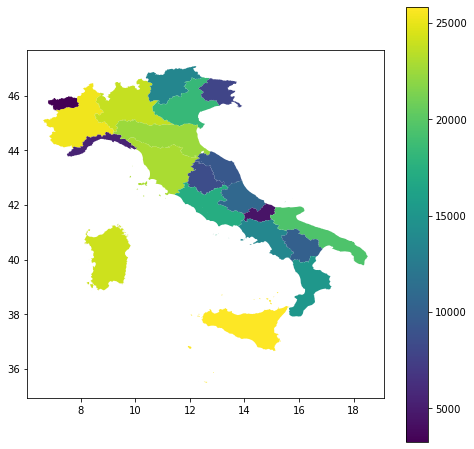

In [40]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(111)
regioni_demogeo.plot(column='superficie', ax=ax, legend=True)

Per le palette di colori di matplotlib: https://matplotlib.org/3.1.0/tutorials/colors/colormaps.html

<AxesSubplot:>

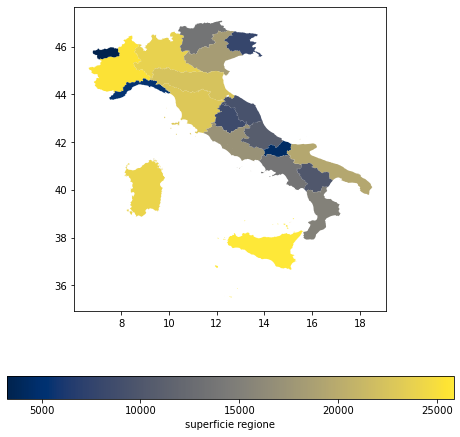

In [41]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(111)
regioni_demogeo.plot(column='superficie', 
                     ax=ax, 
                     legend=True,
                     cmap='cividis',
                    legend_kwds={'label':"superficie regione",
                                 'orientation':"horizontal"
                    })

<AxesSubplot:>

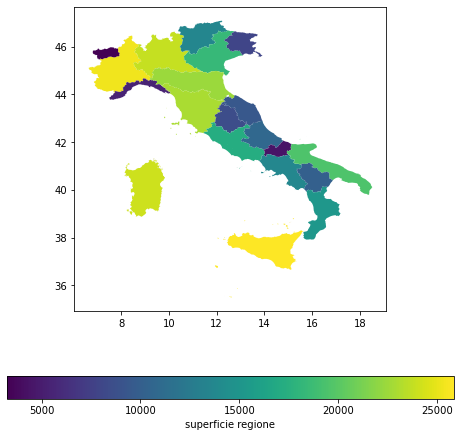

In [42]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(111)
regioni_demogeo.plot(column='superficie', 
                     ax=ax, 
                     legend=True,
                    legend_kwds={'label':"superficie regione",
                                 'orientation':"horizontal"
                    })

__FOLIUM CON GEOPANDAS__

Ora sfruttiamo la facilità di lettura di un file geojson che offre geopandas per avere a disposizione più informazioni da inserire in una choropleth map 

In [75]:
import geopandas as gpd
import pandas as pd
import folium
import branca
import requests
import json
from folium.features import GeoJson, GeoJsonTooltip, GeoJsonPopup, LatLngPopup

Nel modo seguente riesco a caricare come geojson un geodataframe di geopandas.
Attenzione: possono verificarsi molti errori, è fortemente dipendente dalle versioni delle librerie, di python, di conda, etc. Negli esempi che si trovano, è indicato che non serve la conversione a json (regioni_geo2.to_json()). Nel mio caso solo così sono riuscito a farglielo leggere.

In [87]:
m = folium.Map(location=[41.706, 12.568], zoom_start=6)
folium.GeoJson(regioni_geo2.to_json()).add_to(m)

m

Analogo ma con folium.Choropleth

In [89]:
m = folium.Map(location=[41.706, 12.568], zoom_start=6)
folium.Choropleth(regioni_geo2.to_json()).add_to(m)

m

Ora sfruttiamo il fatto di avere anche tutte le variabili del csv originale nel geodataframe regioni_geo2 (superficie, numero comuni, numero provincie etc.). Le variabili che non usiamo per colorare le aree possiamo ora usarle in popup e tooltip arricchiti rispetto al caso visto in precedenza.
In questo modo, con merge di informazioni supplementari al geojson posso fornire un set anche molto ricco di informazioni contestuali, quindi non solo la colorazione.

In [90]:
m = folium.Map(location=[41.706, 12.568], zoom_start=6)

popup = GeoJsonPopup(
    fields=["reg_name", "superficie", "num_residenti", "num_comuni", "num_provincie"],
    aliases=["Regione", "Superficie:", "Residenti:", "Num. Comuni:", "Numero Provincie:"],
    localize=True,
    labels=True,
)

tooltip = GeoJsonTooltip(
    fields=["reg_name", "superficie", "num_residenti", "num_comuni", "num_provincie"],
    aliases=["Regione", "Superficie:", "Residenti:", "Num. Comuni:", "Numero Provincie:"],
    localize=True,
    sticky=False,
    labels=True,
    style="""
        background-color: #F0EFEF;
        border: 2px solid black;
        border-radius: 3px;
        box-shadow: 3px;
    """,
    max_width=800,
)

g = folium.Choropleth(
    geo_data=regioni_demogeo.to_json(),
    name='choropleth',
    data=regioni_demogeo,
    columns=['reg_name', 'num_residenti'],
    key_on='feature.properties.reg_name',
    fill_color='Spectral',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Residenti'
    ).add_to(m)

g.geojson.add_child(tooltip)
g.geojson.add_child(popup)
folium.TileLayer('stamentoner').add_to(m)

m